In [110]:
# import nltk
# from nltk.sentiment import SentimentIntensityAnalyzer
import requests
import mysql.connector
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
from urllib.parse import quote

In [2]:
Comps = ["MSFT", "AAPL", "NVDA", "AVGO", "BRK-B", "JPM",
         "LLY", "UNH", "AMZN", "GE", "GOOG", "WMT", "XOM", "LIN",]

nltk.download('vader_lexicon')
sia = SentimentIntensityAnalyzer()

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/bcalinat/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


### alphavantage

In [111]:
# example of get_news_by_alphavantage returns
# {
#     "feed": [{
#         "title": "Billionaires Are Buying Bitcoin: What Does It Mean for the Future Price of Bitcoin?",
#         "url": "https://www.fool.com/investing/2024/03/22/billionaires-are-buying-bitcoin-what-does-it-mean/",
#         "time_published": "20240322T093000",
#         "authors": [
#             "Dominic Basulto"
#         ],
#         "summary": "If billionaires are embracing crypto, that should send the price of Bitcoin soaring. But it's not guaranteed.",
#         "banner_image": "https://g.foolcdn.com/image/?url=https%3A%2F%2Fg.foolcdn.com%2Feditorial%2Fimages%2F769882%2Fgettyimages-990642348.jpg&op=resize&w=700",
#         "source": "Motley Fool",
#         "category_within_source": "n/a",
#         "source_domain": "www.fool.com",
#         "topics": [
#             {
#                 "topic": "Economy - Monetary",
#                 "relevance_score": "0.451494"
#             },
#             {
#                 "topic": "Retail & Wholesale",
#                 "relevance_score": "0.333333"
#             }
#         ],
#         "overall_sentiment_score": 0.095943,
#         "overall_sentiment_label": "Neutral",
#         "ticker_sentiment": [
#             {
#                 "ticker": "BLK",
#                 "relevance_score": "0.171485",
#                 "ticker_sentiment_score": "0.153551",
#                 "ticker_sentiment_label": "Somewhat-Bullish"
#             },
#             {
#                 "ticker": "MSTR",
#                 "relevance_score": "0.129052",
#                 "ticker_sentiment_score": "0.021225",
#                 "ticker_sentiment_label": "Neutral"
#             }
#         ]
#     }]
# }
        
def get_news_by_alphavantage(query: str, fromTime: str, toTime: str, limit: int = 51):
    def convert_date_format(date_str):
        date_pieces = date_str.split('-')
        month = {'1':'01', '2':'02', '3':'03', '4':'04', '5':'05', '6':'06', '7':'07', '8':'08', '9':'09', '10':'10', '11':'11', '12':'12'}
        date_pieces[1] = month.get(date_pieces[1], date_pieces[1])  
        return f"{date_pieces[0]}{date_pieces[1]}{date_pieces[2]}T0000"

    # apiKey = '5AUQ5HPEMD1DV66G'
    apiKey ='0O2NFVCI7JFQFALE'
    # apiKey = 'TBT09FDFUPGB6BWL'
    query = quote(query)
    url = f'https://www.alphavantage.co/query?function=NEWS_SENTIMENT&tickers={query}&limit={limit}&apikey={apiKey}&time_from={convert_date_format(fromTime)}&time_to={convert_date_format(toTime)}&sort=EARLIEST'
    r = requests.get(url)
    data = r.json()
    return data

In [114]:
get_news_by_alphavantage('BRK-B','2024-03-01','2024-04-01')

{'items': '0',
 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish',
 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.',
 'feed': []}

In [10]:
def convert_date_format(date_str):
    date_pieces = date_str.split('-')
    month = {'1':'01', '2':'02', '3':'03', '4':'04', '5':'05', '6':'06', '7':'07', '8':'08', '9':'09', '10':'10', '11':'11', '12':'12'}
    date_pieces[1] = month.get(date_pieces[1], date_pieces[1])  # 使用 get 方法获取字典值，若不存在则返回原值
    return f"{date_pieces[0]}{date_pieces[1]}{date_pieces[2]}T0000"

In [97]:
t['feed'][0]

{'title': "34 Public Companies That Made Time's 100 Most Influential For 2022: AMC, Disney, Ford And More",
 'url': 'https://www.benzinga.com/node/26413667',
 'time_published': '20220331T232127',
 'authors': [],
 'summary': "Time announced this week its annual 100 Most Influential Companies list. Here's a look at the publicly traded companies that made the list.\nWhat Happened: The 2022 winners were divided into five categories with the Titans category containing the most publicly traded companies of the five groups.\nMan",
 'banner_image': 'https://cdn.benzinga.com/files/imagecache/story_image_685x375C/images/story/2012/screen_shot_2022-03-31_at_7.19.03_pm.png',
 'source': 'Benzinga',
 'category_within_source': 'General',
 'source_domain': 'www.benzinga.com',
 'topics': [{'topic': 'Life Sciences', 'relevance_score': '0.142857'},
  {'topic': 'Energy & Transportation', 'relevance_score': '0.142857'},
  {'topic': 'Technology', 'relevance_score': '0.142857'},
  {'topic': 'Finance', 'relev

In [11]:
# get_month_news_for_company: 对股票(公司)名，获取从202X到202X年每个月的新闻打分细节
def get_month_news_for_company(compName: str, startYear: int, endYear: int):
	news = []
	for y in range(startYear, endYear + 1): # 遍历从202X到202X年
		m = 1
		while m <= 12: # 遍历12个月
            
			if y == 2022 and m < 3:
				m = 3
			if y ==2024 and m >3:
				break
			if m == 12:
				comp_news = get_news_by_alphavantage(compName, f'{y}-{m}-01', f'{y+1}-01-01')
				print('compName:',compName, f'{y}-{m}-01', f'{y+1}-01-01')
			else:
				comp_news = get_news_by_alphavantage(compName, f'{y}-{m}-01', f'{y}-{m+1}-01')
				print('compName:',compName, f'{y}-{m}-01', f'{y}-{m+1}-01')
			print(comp_news)
			print(convert_date_format(f'{y}-{m}-01'))
			for artical in comp_news['feed']:
				news.append({
					'name': compName,
					'url': artical['url'],
					'publishedAt': artical['time_published'],
					'compound': artical['overall_sentiment_score'],
				})
			m+=1
	return news

# 获取所有公司的记录
def get_month_news_for_companies(comps: list, startYear: int, endYear: int):
    return [get_month_news_for_company(comp, startYear, endYear) for comp in comps]

### MSFT

In [12]:
test = get_month_news_for_companies(["MSFT"],2022, 2024)

compName: MSFT 2022-3-01 2022-4-01
{'items': '50', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': [{'title': 'MSFT: Better Buy for 2022: Salesforce.com vs. Microsoft', 'url': 'https://stocknews.com/news/msft-crm-better-buy-for-2022-salesforce-com-vs-microsoft/', 'time_published': '20220301T203854', 'authors': [], 'summary': "The continuation of hybrid working and ongoing digital transformation have been helping the software industry see relentless growth. Moreover, the growing demand for advanced software products and services in almost every sector should support the software industry's growth in the upcoming months. According to Grand View Research, the global business software and services market is expected to grow at a CAGR of 11.3% by 2028.", 'banner_imag

In [21]:
test[0][0]

{'name': 'MSFT',
 'url': 'https://stocknews.com/news/msft-crm-better-buy-for-2022-salesforce-com-vs-microsoft/',
 'publishedAt': '20220301T203854',
 'compound': 0.031452}

In [28]:
MSFT_scores =[]
MSFT_time = []
for i in range(len(test[0])):
    MSFT_scores.append(test[0][i]['compound']) 
    MSFT_time.append(test[0][i]['publishedAt']) 

In [31]:
MSFT = pd.DataFrame({'time':MSFT_time,'scores':MSFT_scores})


In [33]:
MSFT.to_csv('MSFT.csv')

In [ ]:
get_month_news_for_companies(["MSFT"],2022, 2024)

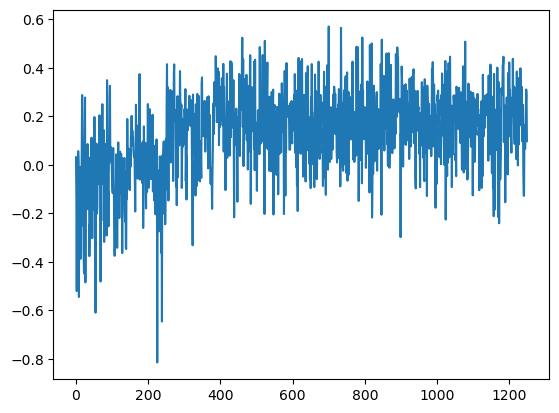

In [27]:
plt.plot(MSFT_scores)

### AAPL

In [34]:
AAPL = get_month_news_for_companies(["AAPL"],2022, 2024)

compName: AAPL 2022-3-01 2022-4-01
{'items': '50', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': [{'title': 'US stocks fall, oil tops $105 as Ukraine crisis rattles markets', 'url': 'https://www.aljazeera.com/economy/2022/3/1/us-stocks-fall-oil-tops-105-as-ukraine-crisis-rattles-markets', 'time_published': '20220301T080000', 'authors': ['Rita Nazareth'], 'summary': 'A surge in oil sent shivers through risky assets Tuesday, reversing an early recovery in American stocks and sending some European markets down 4%. Bonds rallied amid concern about the impact of war on global economies, with 10-year U.S. yields posting their worst four-day drop since December.', 'banner_image': 'https://www.aljazeera.com/wp-content/uploads/2022/03/russia-1.jpg?resize=1200%2C630', '

In [36]:
AAPL_scores =[]
AAPL_time = []
for i in range(len(AAPL[0])):
    AAPL_scores.append(AAPL[0][i]['compound']) 
    AAPL_time.append(AAPL[0][i]['publishedAt']) 
AAPL_df = pd.DataFrame({'time':AAPL_time,'scores':AAPL_scores})

In [37]:
AAPL_df

,time,scores
0,20220301T080000,-0.277460
1,20220302T020013,-0.495467
2,20220302T080000,-0.469431
3,20220302T080000,-0.118323
4,20220303T080000,-0.092622
...,...,...
1245,20240303T093500,0.212768
1246,20240303T100100,0.398793
1247,20240303T101316,0.199883
1248,20240303T104500,0.229195


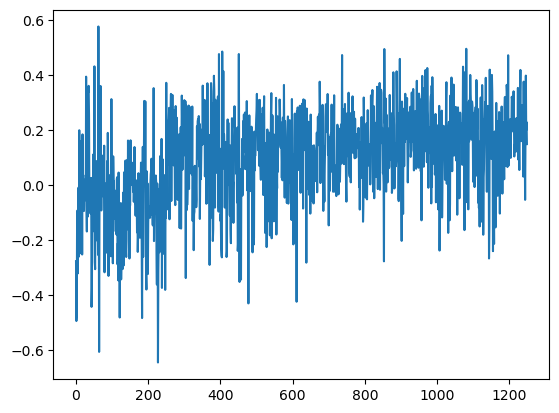

In [38]:
plt.plot(AAPL_scores)

In [39]:
AAPL_df.to_csv('AAPL.csv')

### NVDA

compName: NVDA 2022-3-01 2022-4-01
{'items': '50', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': [{'title': 'MarketingPulse and eTailingPulse to shed light on the metaverse, NFTs and innovative customer experiences', 'url': 'https://www.scmp.com/presented/business/topics/marketing-dawn-metaverse/article/3169039/marketingpulse-and-etailingpulse', 'time_published': '20220303T065619', 'authors': ['Advertising partner'], 'summary': "[Sponsored Article]\r\rThe Covid-19 pandemic has reshaped the world in unforeseen ways, one of which is the acceleration of the rise of virtual communities. Facebook's rebranding into Meta is an important milestone indicating that the metaverse is within reach. It is time for everyone to wrap our head", 'banner_image': 'https://cdn.i-s
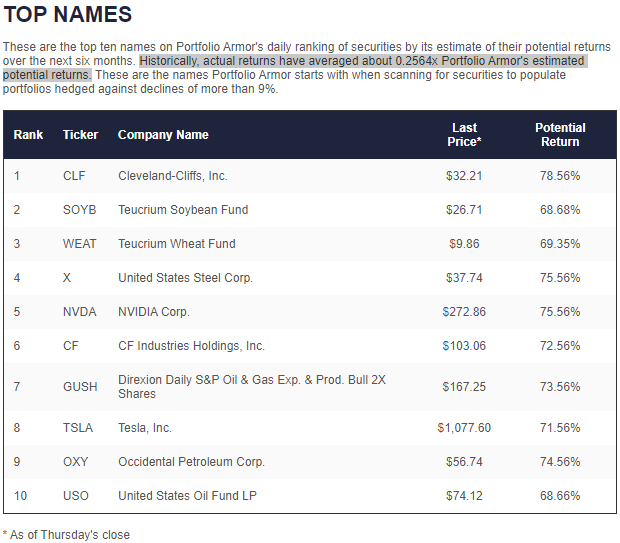
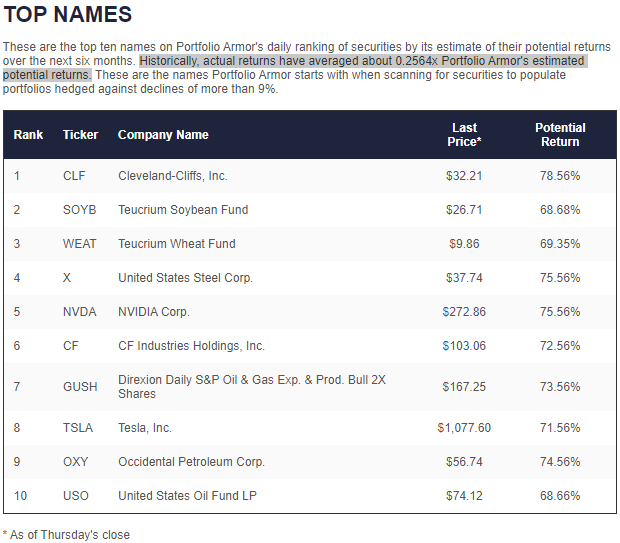
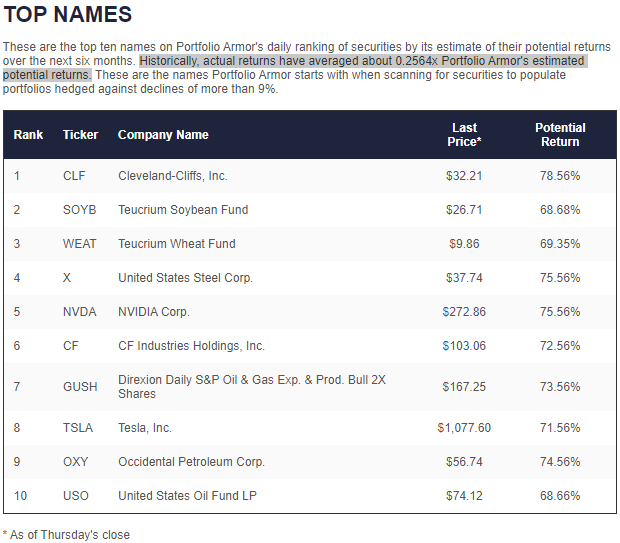

In [40]:
NVDA = get_month_news_for_companies(["NVDA"],2022, 2024)

In [41]:
NVDA_scores =[]
NVDA_time = []
for i in range(len(NVDA[0])):
    NVDA_scores.append(NVDA[0][i]['compound']) 
    NVDA_time.append(NVDA[0][i]['publishedAt']) 
NVDA_df = pd.DataFrame({'time':NVDA_time,'scores':NVDA_scores})

In [42]:
NVDA_df

,time,scores
0,20220303T065619,0.010325
1,20220303T210336,-0.009081
2,20220304T172200,0.125201
3,20220304T193600,-0.311832
4,20220306T000000,-0.365286
...,...,...
1245,20240301T142600,0.341592
1246,20240301T142700,0.313418
1247,20240301T142700,0.177295
1248,20240301T143000,0.240497


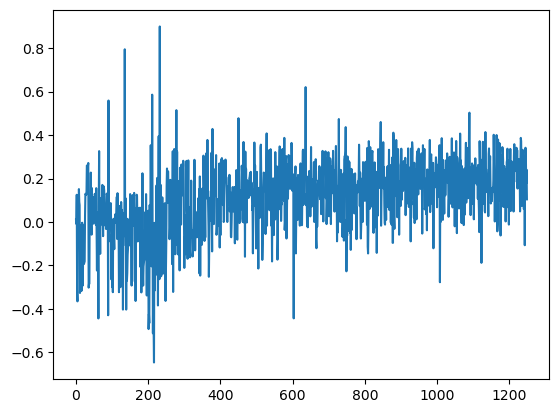

In [43]:
plt.plot(NVDA_scores)

In [44]:
NVDA_df.to_csv('NVDA.csv')

### AVGO

In [45]:
AVGO = get_month_news_for_companies(["AVGO"],2022, 2024)

compName: AVGO 2022-3-01 2022-4-01
{'items': '50', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': [{'title': 'Market Rallies, But Still Must Do This; 5 Stocks Near Buy Points', 'url': 'https://www.investors.com/market-trend/stock-market-today/dow-jones-futures-stock-market-rallies-on-nimble-fed-5-chips-near-buys-snow-stock-crashes/', 'time_published': '20220303T080000', 'authors': ["Investor's Business Daily", 'ED CARSON'], 'summary': "Dow Jones Futures: Stock Market Rallies On 'Nimble' Fed, But Must Do This; SNOW Stock Crashes Investor's Business Daily", 'banner_image': 'https://www.investors.com/wp-content/uploads/2016/03/BIGPIC-032316-shutterstock.jpg', 'source': 'Investors Business Daily', 'category_within_source': 'n/a', 'source_domain': 'www.investors.com

In [46]:
AVGO_scores =[]
AVGO_time = []
for i in range(len(AVGO[0])):
    AVGO_scores.append(AVGO[0][i]['compound']) 
    AVGO_time.append(AVGO[0][i]['publishedAt']) 
AVGO_df = pd.DataFrame({'time':AVGO_time,'scores':AVGO_scores})

In [47]:
AVGO_df

,time,scores
0,20220303T080000,-0.092622
1,20220303T201500,0.150597
2,20220304T102419,-0.039211
3,20220304T130339,-0.103751
4,20220304T151933,-0.061315
...,...,...
1245,20240307T075242,0.292673
1246,20240307T093100,0.136973
1247,20240307T114343,-0.052813
1248,20240307T132400,0.150950


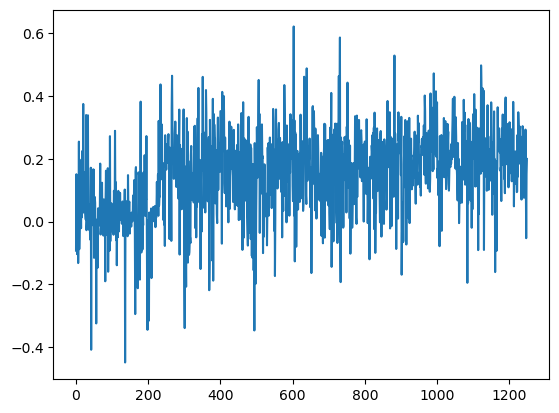

In [48]:
plt.plot(AVGO_scores)

In [49]:
AVGO_df.to_csv('AVGO.csv')

### BRK-B

In [105]:
# BRK_B = get_month_news_for_companies(["BRK-B"],2022, 2024)

compName: BRK-B 2022-3-01 2022-4-01
{'items': '0', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': []}
20220301T0000
compName: BRK-B 2022-4-01 2022-5-01
{'items': '0', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': []}
20220401T0000
compName: BRK-B 2022-5-01 2022-6-01
{'items': '0', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher rele

### JPM

In [108]:
JPM = get_month_news_for_companies(["JPM"],2022, 2024)

compName: JPM 2022-3-01 2022-4-01
{'Information': 'Invalid inputs. Please refer to the API documentation https://www.alphavantage.co/documentation#newsapi and try again.'}
20220301T0000


KeyError: 'feed'

### LLY

In [56]:
LLY = get_month_news_for_companies(["LLY"],2022, 2024)

compName: LLY 2022-3-01 2022-4-01
{'items': '0', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': []}
20220301T0000
compName: LLY 2022-4-01 2022-5-01
{'items': '0', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': []}
20220401T0000
compName: LLY 2022-5-01 2022-6-01
{'items': '4', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.

In [57]:
LLY_scores =[]
LLY_time = []
for i in range(len(LLY[0])):
    LLY_scores.append(LLY[0][i]['compound']) 
    LLY_time.append(LLY[0][i]['publishedAt']) 
LLY_df = pd.DataFrame({'time':LLY_time,'scores':LLY_scores})

In [58]:
LLY_df

,time,scores
0,20220512T151500,0.064239
1,20220519T133200,0.021270
2,20220520T132500,-0.011469
3,20220523T170039,-0.113675
4,20220711T135100,0.079713
...,...,...
1045,20240308T150500,0.180612
1046,20240308T155800,0.032056
1047,20240308T155933,0.193082
1048,20240308T160013,0.193839


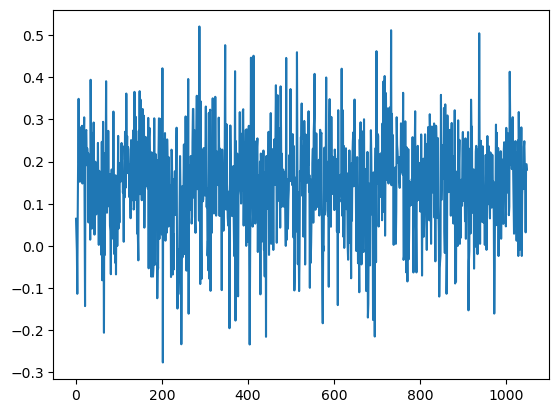

In [60]:
plt.plot(LLY_scores)

In [61]:
LLY_df.to_csv('LLY.csv')

### UNH

In [62]:
UNH = get_month_news_for_companies(["UNH"],2022, 2024)

compName: UNH 2022-3-01 2022-4-01
{'items': '50', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': [{'title': 'Are You a Growth Investor? This 1 Stock Could Be the Perfect Pick', 'url': 'https://www.zacks.com/stock/news/1877570/are-you-a-growth-investor-this-1-stock-could-be-the-perfect-pick', 'time_published': '20220304T150007', 'authors': ['Zacks Investment Research'], 'summary': "The Zacks Style Scores offers investors a way to easily find top-rated stocks based on their investing style. Here's why you should take advantage.", 'banner_image': 'https://staticx-tuner.zacks.com/images/default_article_images/default154.jpg', 'source': 'Zacks Commentary', 'category_within_source': 'n/a', 'source_domain': 'www.zacks.com', 'topics': [{'topic': 'Earnings', 'relevance_

In [63]:
UNH_scores =[]
UNH_time = []
for i in range(len(UNH[0])):
    UNH_scores.append(UNH[0][i]['compound']) 
    UNH_time.append(UNH[0][i]['publishedAt']) 
UNH_df = pd.DataFrame({'time':UNH_time,'scores':UNH_scores})

In [64]:
UNH_df

,time,scores
0,20220304T150007,0.277246
1,20220304T172200,0.125201
2,20220304T173700,-0.218787
3,20220307T112008,0.040195
4,20220307T153223,-0.008047
...,...,...
1245,20240313T201000,0.359813
1246,20240313T204900,0.021573
1247,20240313T210259,0.017108
1248,20240313T221853,0.160281


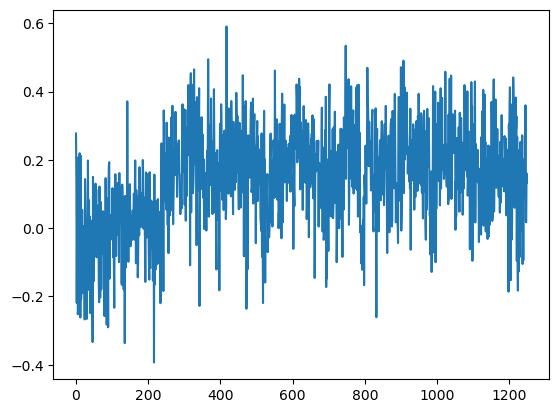

In [65]:
plt.plot(UNH_scores)

In [67]:
UNH_df.to_csv('UNH.csv')

### AMZN

In [68]:
AMZN = get_month_news_for_companies(["AMZN"],2022, 2024)

compName: AMZN 2022-3-01 2022-4-01
{'items': '50', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': [{'title': 'Nasdaq moves into positive territory as broader market bounces off its lows', 'url': 'https://www.cnn.com/business/live-news/stock-market-news-russia-ukraine-22722/h_96f7efb5da6e05344355ebeecc43dc3c', 'time_published': '20220301T080000', 'authors': ['By CNN Business'], 'summary': 'Live updates: Dow tumbles as Russia threatens the West CNN', 'banner_image': 'https://dynaimage.cdn.cnn.com/cnn/digital-images/org/885d5541-45dd-402c-a63a-149df355a138.JPG', 'source': 'CNN', 'category_within_source': 'Markets', 'source_domain': 'www.cnn.com', 'topics': [{'topic': 'Economy - Monetary', 'relevance_score': '0.576289'}, {'topic': 'Retail & Wholesale', 'relevance_s

In [69]:
AMZN_scores =[]
AMZN_time = []
for i in range(len(AMZN[0])):
    AMZN_scores.append(AMZN[0][i]['compound']) 
    AMZN_time.append(AMZN[0][i]['publishedAt']) 
AMZN_df = pd.DataFrame({'time':AMZN_time,'scores':AMZN_scores})

In [70]:
AMZN_df

,time,scores
0,20220301T080000,-0.337465
1,20220301T212653,-0.056675
2,20220303T172517,-0.041040
3,20220303T201500,0.150597
4,20220304T114200,-0.074308
...,...,...
1245,20240304T190300,0.026734
1246,20240304T201939,0.514928
1247,20240304T221000,0.208179
1248,20240305T011200,0.199342


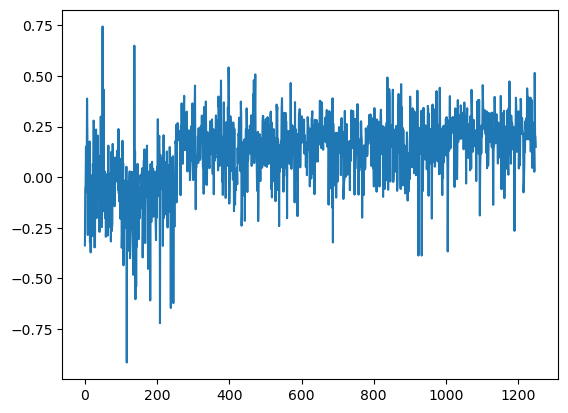

In [71]:
plt.plot(AMZN_scores)

In [72]:
AMZN_df.to_csv('AMZN.csv')

### GE

In [73]:
GE = get_month_news_for_companies(["GE"],2022, 2024)

compName: GE 2022-3-01 2022-4-01
{'items': '50', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': [{'title': 'Are You an Investor Needing Some Calm Guidance?', 'url': 'https://www.fool.com/investing/2022/03/03/are-you-an-investor-needing-some-calm-guidance/', 'time_published': '20220303T172517', 'authors': ['Chris Hill and Maria Gallagher'], 'summary': 'Read this.', 'banner_image': 'https://g.foolcdn.com/editorial/images/669041/gettyimages-935608320.jpg', 'source': 'Motley Fool', 'category_within_source': 'n/a', 'source_domain': 'www.fool.com', 'topics': [{'topic': 'Life Sciences', 'relevance_score': '0.2'}, {'topic': 'Technology', 'relevance_score': '0.2'}, {'topic': 'Finance', 'relevance_score': '0.2'}, {'topic': 'Economy - Monetary', 'relevance_score': '0.3108

In [74]:
GE_scores =[]
GE_time = []
for i in range(len(GE[0])):
    GE_scores.append(GE[0][i]['compound']) 
    GE_time.append(GE[0][i]['publishedAt']) 
GE_df = pd.DataFrame({'time':GE_time,'scores':GE_scores})

In [75]:
GE_df

,time,scores
0,20220303T172517,-0.041040
1,20220304T160140,0.010127
2,20220306T080000,0.207867
3,20220307T093000,0.034744
4,20220307T103000,0.009586
...,...,...
1245,20240315T080000,0.394514
1246,20240315T091200,0.349295
1247,20240315T103000,0.072026
1248,20240315T125013,0.264142


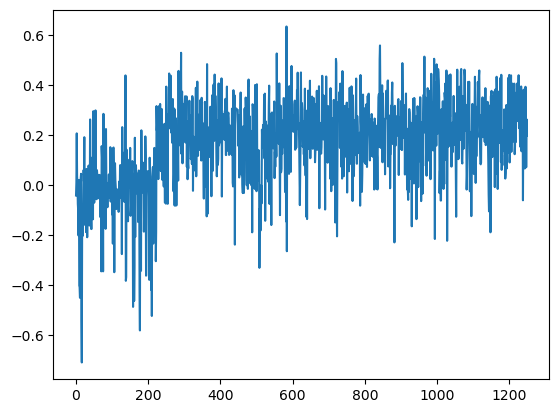

In [76]:
plt.plot(GE_scores)

In [77]:
GE_df.to_csv('GE.csv')

### GOOG

In [78]:
GOOG = get_month_news_for_companies(["GOOG"],2022, 2024)

compName: GOOG 2022-3-01 2022-4-01
{'items': '50', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': [{'title': 'Facebook, Instagram demoting posts from Russian state-media', 'url': 'https://www.aljazeera.com/economy/2022/3/1/facebook-instagram-demoting-posts-from-russian-state-media', 'time_published': '20220301T080000', 'authors': [], 'summary': "Meta Platforms is globally demoting content from Russian state-controlled media outlets' Facebook pages and Instagram accounts, as well as posts containing links to those outlets on Facebook, the company's head of global affairs said on Tuesday.", 'banner_image': 'https://www.aljazeera.com/wp-content/uploads/2022/03/socialmedia.jpg?resize=1200%2C630', 'source': 'Al Jareeza', 'category_within_source': 'n/a', 'source_doma

In [79]:
GOOG_scores =[]
GOOG_time = []
for i in range(len(GOOG[0])):
    GOOG_scores.append(GOOG[0][i]['compound']) 
    GOOG_time.append(GOOG[0][i]['publishedAt']) 
GOOG_df = pd.DataFrame({'time':GOOG_time,'scores':GOOG_scores})

In [80]:
GOOG_df

,time,scores
0,20220301T080000,-0.092611
1,20220301T080000,-0.116043
2,20220302T041700,-0.382544
3,20220302T080000,-0.380011
4,20220302T080000,-0.520567
...,...,...
1245,20240301T112007,0.234049
1246,20240301T112600,0.109300
1247,20240301T113000,0.310772
1248,20240301T113000,0.253360


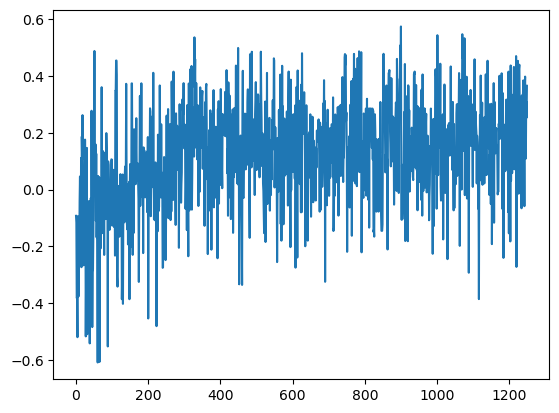

In [82]:
plt.plot(GOOG_scores)

In [83]:
GOOG_df.to_csv('GOOG.csv')

### WMT

In [84]:
WMT = get_month_news_for_companies(["WMT"],2022, 2024)

compName: WMT 2022-3-01 2022-4-01
{'items': '50', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': [{'title': 'When Is Amazon Prime Day 2022?', 'url': 'https://www.kiplinger.com/personal-finance/shopping/online-shopping/604290/when-is-amazon-prime-day', 'time_published': '20220301T212653', 'authors': ['Bob Niedt'], 'summary': "Bargain hunters know the annual Amazon Prime Day retailpalooza as an opportunity to score a bevy of deals on all manner of merchandise. That's why they eagerly await the two-day event.\n SEE MORE 40 Best Amazon Prime Benefits to Use in 2022 \nWhile specific dates haven't yet been announced, we at leas", 'banner_image': 'https://mediacloud.kiplinger.com/image/private/s--AK2SVMUH--/f_auto,t_primary-image-mobile@1/v1651246585/rn_PrimeDayJuly.j

In [85]:
WMT_scores =[]
WMT_time = []
for i in range(len(WMT[0])):
    WMT_scores.append(WMT[0][i]['compound']) 
    WMT_time.append(WMT[0][i]['publishedAt']) 
WMT_df = pd.DataFrame({'time':WMT_time,'scores':WMT_scores})

In [86]:
WMT_df

,time,scores
0,20220301T212653,-0.056675
1,20220302T080000,-0.137569
2,20220302T222604,-0.242739
3,20220303T172008,0.128489
4,20220303T213922,-0.080803
...,...,...
1245,20240304T205100,0.418869
1246,20240304T205113,0.354311
1247,20240304T210100,0.336957
1248,20240305T000500,0.188825


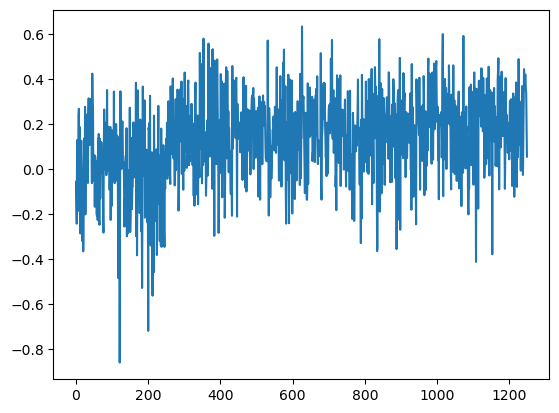

In [87]:
plt.plot(WMT_scores)

In [88]:
WMT_df.to_csv('WMT.csv')

### XOM

In [89]:
XOM = get_month_news_for_companies(["XOM"],2022, 2024)

compName: XOM 2022-3-01 2022-4-01
{'items': '50', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': [{'title': 'Russia tries to stop Western companies fleeing the country', 'url': 'https://www.cnn.com/2022/03/01/investing/russia-economy-capital-controls/index.html', 'time_published': '20220301T080000', 'authors': ['CNN Business', 'Mark Thompson and Vasco Cotovio'], 'summary': 'London/Moscow  (  CNN Business  )  Russian President Vladimir Putin is trying to stem the flow of Western businesses fleeing the country over his decision to wage war on Ukraine.', 'banner_image': 'https://cdn.cnn.com/cnnnext/dam/assets/220228043808-russia-atm-line-02272022-large-169.jpg', 'source': 'CNN', 'category_within_source': 'Markets', 'source_domain': 'www.cnn.com', 'topics': [{'topi

In [92]:
XOM_scores =[]
XOM_time = []
for i in range(len(XOM[0])):
    XOM_scores.append(XOM[0][i]['compound']) 
    XOM_time.append(XOM[0][i]['publishedAt']) 
XOM_df = pd.DataFrame({'time':XOM_time,'scores':XOM_scores})

In [93]:
XOM_df

,time,scores
0,20220301T080000,-0.291782
1,20220301T080000,-0.362344
2,20220301T080000,-0.205053
3,20220301T125836,-0.138797
4,20220302T023256,-0.031243
...,...,...
1245,20240311T131600,0.372473
1246,20240311T140000,0.579266
1247,20240311T144608,0.188140
1248,20240311T172829,0.144178


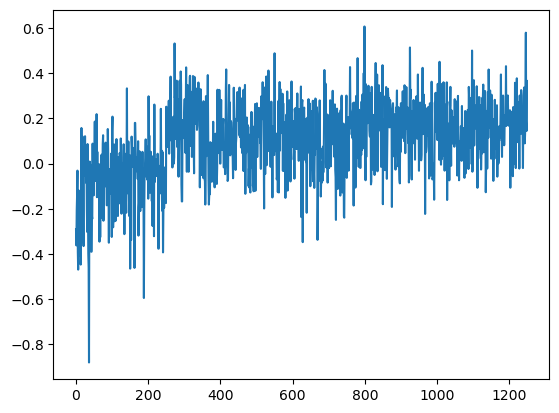

In [94]:
plt.plot(XOM_scores)

In [95]:
XOM_df.to_csv('XOM.csv')

### LIN

In [91]:
LIN = get_month_news_for_companies(["LIN"],2022, 2024)

compName: LIN 2022-3-01 2022-4-01
{'items': '9', 'sentiment_score_definition': 'x <= -0.35: Bearish; -0.35 < x <= -0.15: Somewhat-Bearish; -0.15 < x < 0.15: Neutral; 0.15 <= x < 0.35: Somewhat_Bullish; x >= 0.35: Bullish', 'relevance_score_definition': '0 < x <= 1, with a higher score indicating higher relevance.', 'feed': [{'title': 'This Stock Could Be a Major Winner in Hydrogen Energy', 'url': 'https://www.fool.com/investing/2022/03/06/this-stock-could-be-a-major-winner-in-hydrogen-ene/', 'time_published': '20220306T113000', 'authors': ['Jason Hall'], 'summary': 'Linde has consistently generated incredible returns.', 'banner_image': 'https://g.foolcdn.com/editorial/images/669238/gettyimages-1320686132.jpg', 'source': 'Motley Fool', 'category_within_source': 'n/a', 'source_domain': 'www.fool.com', 'topics': [{'topic': 'Life Sciences', 'relevance_score': '0.5'}, {'topic': 'Manufacturing', 'relevance_score': '0.5'}], 'overall_sentiment_score': 0.619608, 'overall_sentiment_label': 'Bull

In [96]:
LIN_scores =[]
LIN_time = []
for i in range(len(LIN[0])):
    LIN_scores.append(LIN[0][i]['compound']) 
    LIN_time.append(LIN[0][i]['publishedAt']) 
LIN_df = pd.DataFrame({'time':LIN_time,'scores':LIN_scores})

In [97]:
LIN_df

,time,scores
0,20220306T113000,0.619608
1,20220308T112007,0.029527
2,20220310T141400,0.098308
3,20220314T145835,-0.250674
4,20220316T152500,-0.185964
...,...,...
641,20240327T113800,0.296809
642,20240327T131333,0.228489
643,20240328T080000,0.351409
644,20240328T201500,0.370743


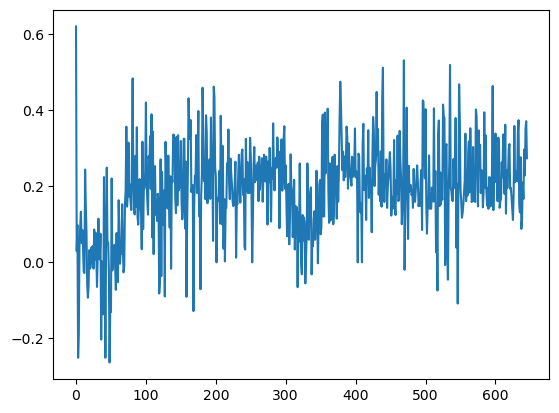

In [98]:
plt.plot(LIN_scores)

In [99]:
LIN_df.to_csv('LIN.csv')